In [312]:
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt

sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=100, facecolor='white', frameon=True, fontsize=20, figsize=(12, 12))



endo = ['PECAM1']
mes1 = [ 'CHI3L1', 'ANXA2', 'ANXA1', 'CD44', 'VIM', 'MT2A', 'C1S', 'NAMPT', 'EFEMP1',
    'C1R', 'SOD2', 'IFITM3', 'TIMP1', 'SPP1', 'A2M', 'S100A11', 'MT1X', 'S100A10', 'FN1',
    'LGALS1', 'S100A16', 'CLIC1', 'MGST1', 'RCAN1', 'TAGLN2', 'NPC2', 'SERPING1', 'C8orf4', 'EMP1',
    'APOE', 'CTSB', 'C3', 'LGALS3', 'MT1E', 'EMP3', 'SERPINA3', 'ACTN1', 'PRDX6', 'IGFBP7',
    'SERPINE1', 'PLP2', 'MGP', 'CLIC4', 'GFPT2', 'GSN', 'NNMT', 'TUBA1C', 'GJA1', 'TNFRSF1A', 'WWTR1'
]
mes2 = [
    'HILPDA', 'ADM', 'DDIT3', 'NDRG1', 'HERPUD1', 'DNAJB9', 'TRIB3', 'ENO2', 'AKAP12',
    'SQSTM1', 'MT1X', 'ATF3', 'NAMPT', 'NRN1', 'SLC2A1', 'BNIP3', 'LGALS3', 'INSIG2', 'IGFBP3',
    'PPP1R15A', 'VIM', 'PLOD2', 'GBE1', 'SLC2A3', 'FTL', 'WARS', 'ERO1L', 'XPOT', 'HSPA5',
    'GDF15', 'ANXA2', 'EPAS1', 'LDHA', 'P4HA1', 'SERTAD1', 'PFKP', 'PGK1', 'EGLN3', 'SLC6A6',
    'CA9', 'BNIP3L', 'RPL21', 'TRAM1', 'UFM1', 'ASNS', 'GOLT1B', 'ANGPTL4', 'SLC39A14', 'CDKN1A', 'HSPA9'
]
mes = mes1 + mes2

ac = ['CST3', 'S100B', 'SLC1A3', 'HEPN1', 'HOPX', 'MT3', 'SPARCL1', 'MLC1', 'GFAP',
    'FABP7', 'BCAN', 'PON2', 'METTL7B', 'SPARC', 'GATM', 'RAMP1', 'PMP2', 'AQP4', 'DBI',
    'EDNRB', 'PTPRZ1', 'CLU', 'PMP22', 'ATP1A2', 'S100A16', 'HEY1', 'PCDHGC3', 'TTYH1', 'NDRG2',
    'PRCP', 'ATP1B2', 'AGT', 'PLTP', 'GPM6B', 'F3', 'RAB31', 'PPAP2B', 'ANXA5', 'TSPAN7'
]

opc = ['BCAN', 'PLP1', 'GPR17', 'FIBIN', 'LHFPL3', 'OLIG1', 'PSAT1', 'SCRG1', 'OMG',
    'APOD', 'SIRT2', 'TNR', 'THY1', 'PHYHIPL', 'SOX2-OT', 'NKAIN4', 'LPPR1', 'PTPRZ1', 'VCAN',
    'DBI', 'PMP2', 'CNP', 'TNS3', 'LIMA1', 'CA10', 'PCDHGC3', 'CNTN1', 'SCD5', 'P2RX7',
    'CADM2', 'TTYH1', 'FGF12', 'TMEM206', 'NEU4', 'FXYD6', 'RNF13', 'RTKN', 'GPM6B', 'LMF1',
    'ALCAM', 'PGRMC1', 'HRASLS', 'BCAS1', 'RAB31', 'PLLP', 'FABP5', 'NLGN3', 'SERINC5', 'EPB41L2', 'GPR37L1'
]

npc1 = ['DLL3', 'DLL1', 'SOX4', 'TUBB3', 'HES6', 'TAGLN3', 'NEU4', 'MARCKSL1', 'CD24',
    'STMN1', 'TCF12', 'BEX1', 'OLIG1', 'MAP2', 'FXYD6', 'PTPRS', 'MLLT11', 'NPPA', 'BCAN',
    'MEST', 'ASCL1', 'BTG2', 'DCX', 'NXPH1', 'HN1', 'PFN2', 'SCG3', 'MYT1', 'CHD7',
    'GPR56', 'TUBA1A', 'PCBP4', 'ETV1', 'SHD', 'TNR', 'AMOTL2', 'DBN1', 'HIP1', 'ABAT',
    'ELAVL4', 'LMF1', 'GRIK2', 'SERINC5', 'TSPAN13', 'ELMO1', 'GLCCI1', 'SEZ6L', 'LRRN1', 'SEZ6', 'SOX11'
]

npc2 = ['STMN2', 'CD24', 'RND3', 'HMP19', 'TUBB3', 'MIAT', 'DCX', 'NSG1', 'ELAVL4',
    'MLLT11', 'DLX6-AS1', 'SOX11', 'NREP', 'FNBP1L', 'TAGLN3', 'STMN4', 'DLX5', 'SOX4', 'MAP1B',
    'RBFOX2', 'IGFBPL1', 'STMN1', 'HN1', 'TMEM161B-AS1', 'DPYSL3', 'SEPT3', 'PKIA', 'ATP1B1', 'DYNC1I1',
    'CD200', 'SNAP25', 'PAK3', 'NDRG4', 'KIF5A', 'UCHL1', 'ENO2', 'KIF5C', 'DDAH2', 'TUBB2A',
    'LBH', 'LOC150568', 'TCF4', 'GNG3', 'NFIB', 'DPYSL5', 'CRABP1', 'DBN1', 'NFIX', 'CEP170', 'BLCAP'
]
npc = npc1 + npc2

g1_s = ['RRM2', 'PCNA', 'KIAA0101', 'HIST1H4C', 'MLF1IP', 'GMNN', 'RNASEH2A', 'MELK', 'CENPK', 'TK1',
    'TMEM106C', 'CDCA5', 'CKS1B', 'CDC45', 'MCM3', 'CENPM', 'AURKB', 'PKMYT1', 'MCM4', 'ASF1B',
    'GINS2', 'MCM2', 'FEN1', 'RRM1', 'DUT', 'RAD51AP1', 'MCM7', 'CCNE2', 'ZWINT'
]

g2_m = ['CCNB1', 'CDC20', 'CCNB2', 'PLK1', 'CCNA2', 'CKAP2', 'KNSTRN', 'RACGAP1', 'CDCA3', 'TROAP',
    'KIF2C', 'AURKA', 'CENPF', 'KPNA2', 'KIF20A', 'ECT2', 'BUB1', 'CDCA8', 'BUB1B', 'TACC3',
    'TTK', 'TUBA1C', 'NCAPD2', 'ARL6IP1', 'KIF4A', 'CKAP2L', 'MZT1', 'KIFC1', 'SPAG5', 'ANP32E',
    'KIF11', 'PSRC1', 'TUBB4B', 'SMC4', 'MXD3', 'CDC25B', 'OIP5', 'REEP4', 'FOXM1', 'TMPO',
    'GPSM2', 'HMGB3', 'ARHGAP11A', 'RANGAP1', 'H2AFZ'
]

stemness = ["SOX4", "CCND2", "SOX11", "RBM6", "HNRNPH1", "HNRNPL", "PTMA", "TRA2A", "SET", "C6orf62",
    "PTPRS", "CHD7", "CD24", "H3F3B", "C14orf23", "NFIB", "SRGAP2C", "STMN2", "SOX2", "TFDP2",
    "CORO1C", "EIF4B", "FBLIM1", "SPDYE7P", "TCF4", "ORC6", "SPDYE1", "NCRUPAR", "BAZ2B", "NELL2",
    "OPHN1", "SPHKAP", "RAB42", "LOH12CR2", "ASCL1", "BOC", "ZBTB8A", "ZNF793", "TOX3", "EGFR",
    "PGM5P2", "EEF1A1", "MALAT1", "TATDN3", "CCL5", "EVI2A", "LYZ", "POU5F1", "FBXO27", "CAMK2N1",
    "NEK5", "PABPC1", "AFMID", "QPCTL", "MBOAT1", "HAPLN1", "LOC90834", "LRTOMT", "GATM-AS1",
    "AZGP1", "RAMP2-AS1", "SPDYE5", "TNFAIP8L1"
]

opc_npc = npc + opc
subset_genes = endo + mes + ac + opc + npc
all_genes =  g1_s + g2_m + stemness + npc + opc + mes + ac + endo 

scanpy==1.9.6 anndata==0.10.4 umap==0.5.5 numpy==1.26.3 scipy==1.11.4 pandas==2.1.4 scikit-learn==1.3.2 statsmodels==0.14.1 igraph==0.10.8 louvain==0.8.1 pynndescent==0.5.11


In [313]:
adata = sc.read('write/human_combined_3.h5ad')
# sc.pp.log1p(adata)
# redo neighbors and umap
# sc.pp.neighbors(adata, n_pcs=13, n_neighbors=10)

/Users/shaunie/Desktop/hu-glioblastoma/.conda/lib/python3.11/site-packages/anndata/__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


/Users/shaunie/Desktop/hu-glioblastoma/.conda/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/shaunie/Desktop/hu-glioblastoma/.conda/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


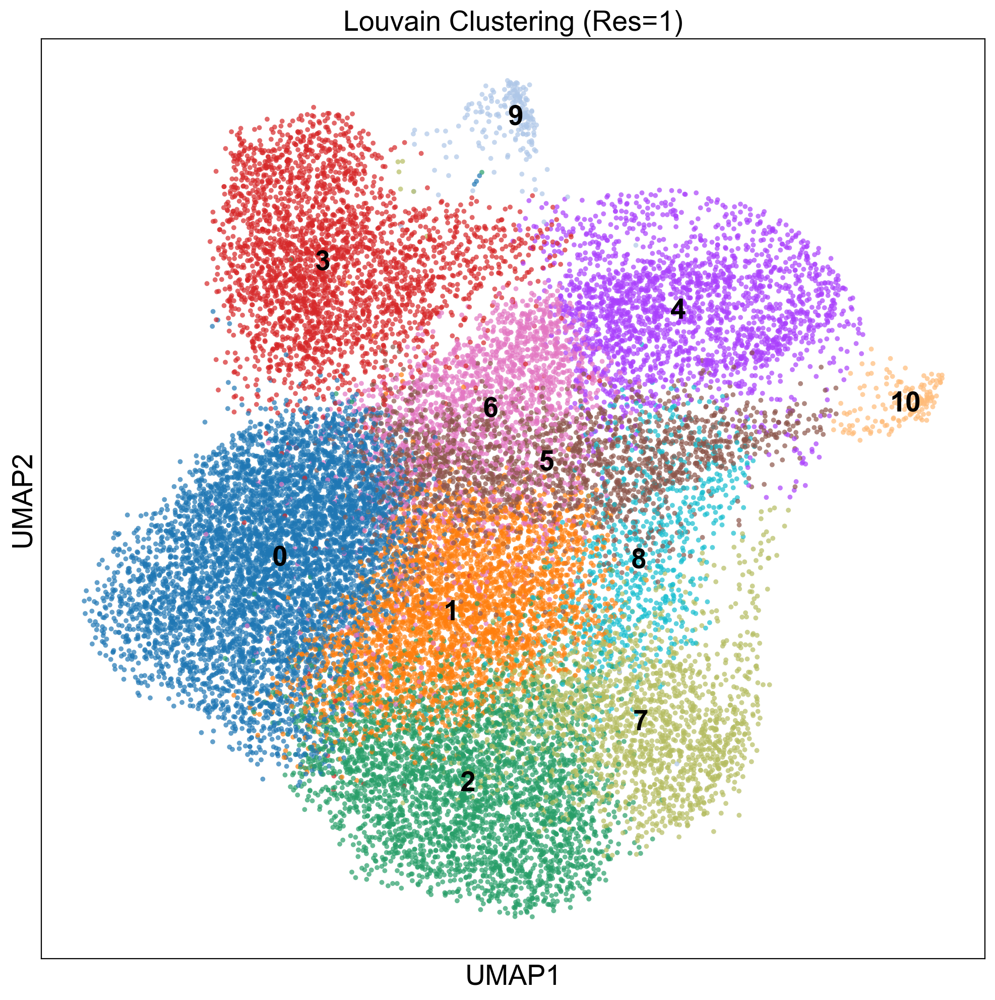

In [314]:

sc.pl.umap(adata, color="louvain", size=50, alpha=0.7, legend_loc="on data", title="Louvain Clustering (Res=1)")


/Users/shaunie/Desktop/hu-glioblastoma/.conda/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/shaunie/Desktop/hu-glioblastoma/.conda/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


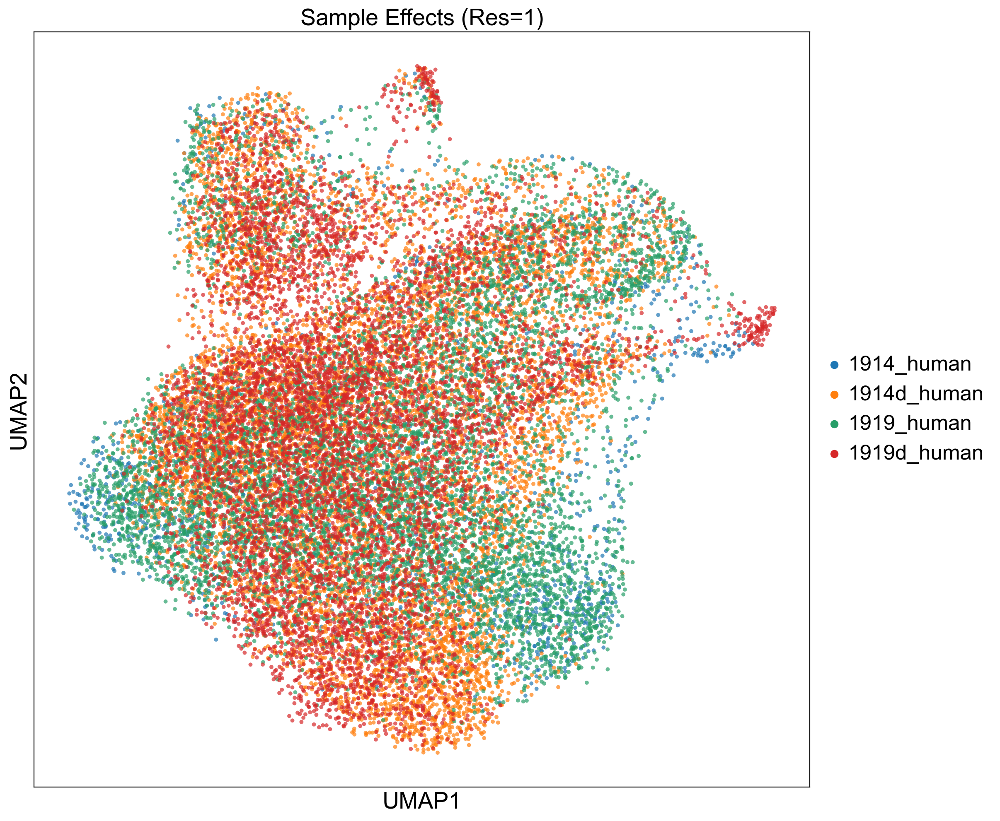

In [315]:
sc.pl.umap(adata, color="batch", size=50, alpha=0.7, title="Sample Effects (Res=1)")


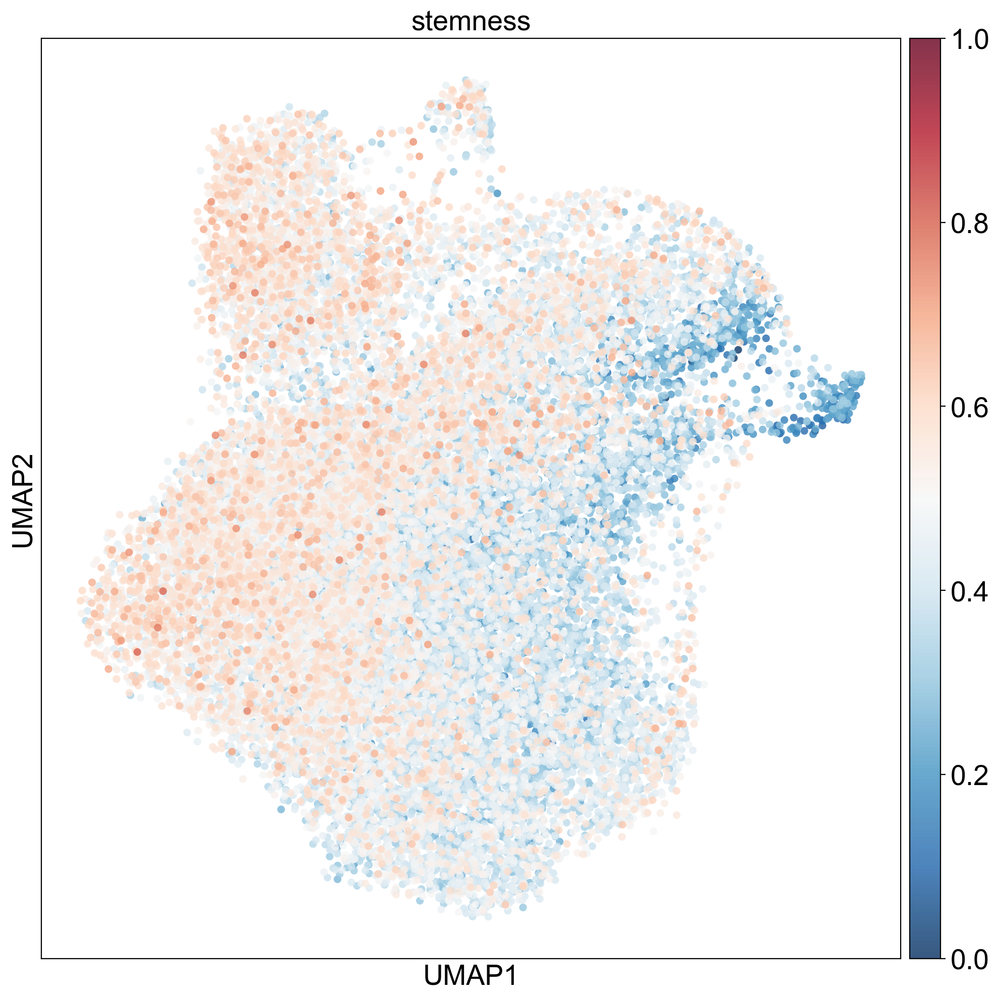

In [316]:
# sc.pl.umap(adata, color=stemness_like, size=70)
# add up the expression of stemness_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, stemness].X.toarray()
except KeyError:
    stemness = [g for g in stemness if g in adata.var_names]
    data = adata[:, stemness].X.toarray()
    
gene_number = len(stemness)
stemness_expression = np.sum(data, axis=1)
# normalize to the total expression
stemness_expression = stemness_expression / gene_number
adata.obs = adata.obs.assign(stemness_expression=pd.Series(stemness_expression, index=adata.obs.index))
sc.pl.umap(adata, color='stemness_expression', vmin=0, vmax=1, size=120, alpha=0.8, title='stemness', cmap='RdBu_r' )



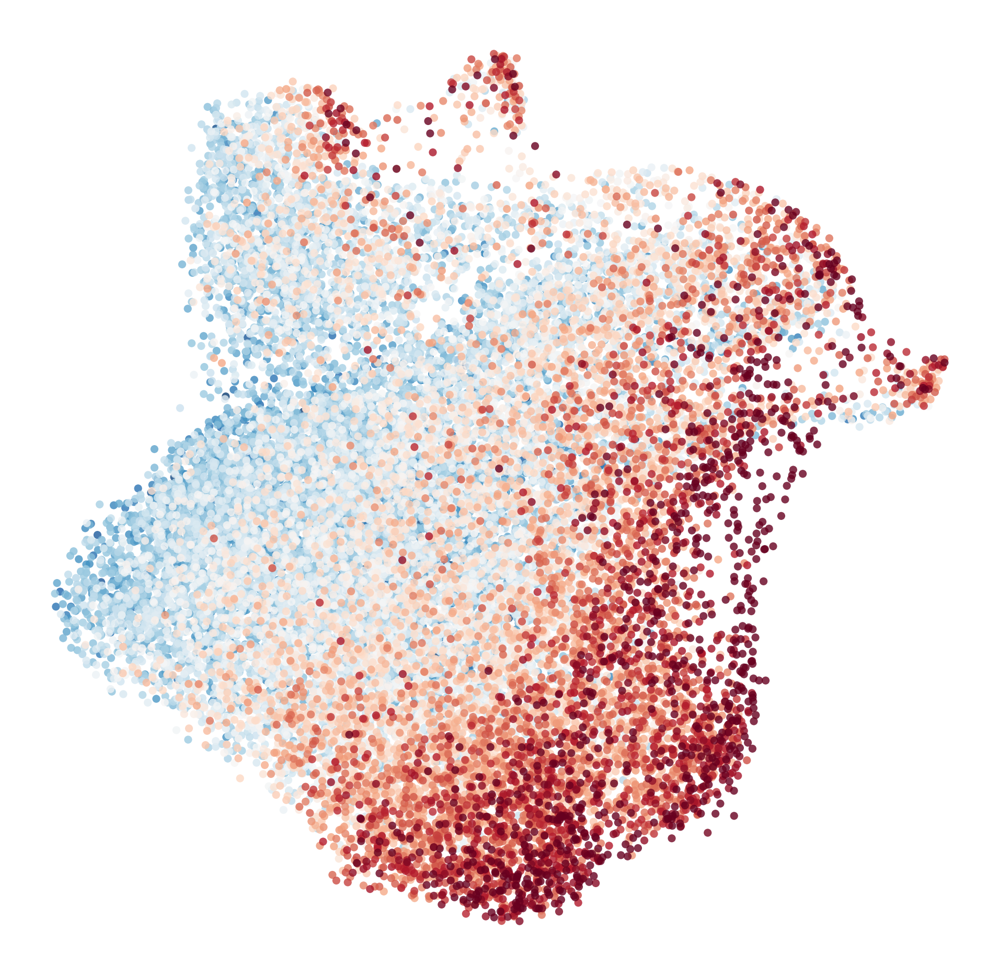

In [317]:
# sc.pl.umap(adata, color=mes_like, size=70)
# add up the expression of mes_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, mes].X.toarray()
except KeyError:
    mes = [g for g in mes if g in adata.var_names]
    data = adata[:, mes].X.toarray()
    
gene_number = len(stemness)
mes_expression = np.sum(data, axis=1)
mes_expression = mes_expression / gene_number
adata.obs['mes_expression'] = mes_expression
adata.obs = adata.obs.assign(mes_expression=pd.Series(mes_expression, index=adata.obs.index))
# set mes_expression as a obs
sc.pl.umap(adata, color='mes_expression', vmin=0, vmax=1, size=120, alpha=0.8, title='', cmap='RdBu_r' ,frameon=False, legend_loc=None, colorbar_loc=None)



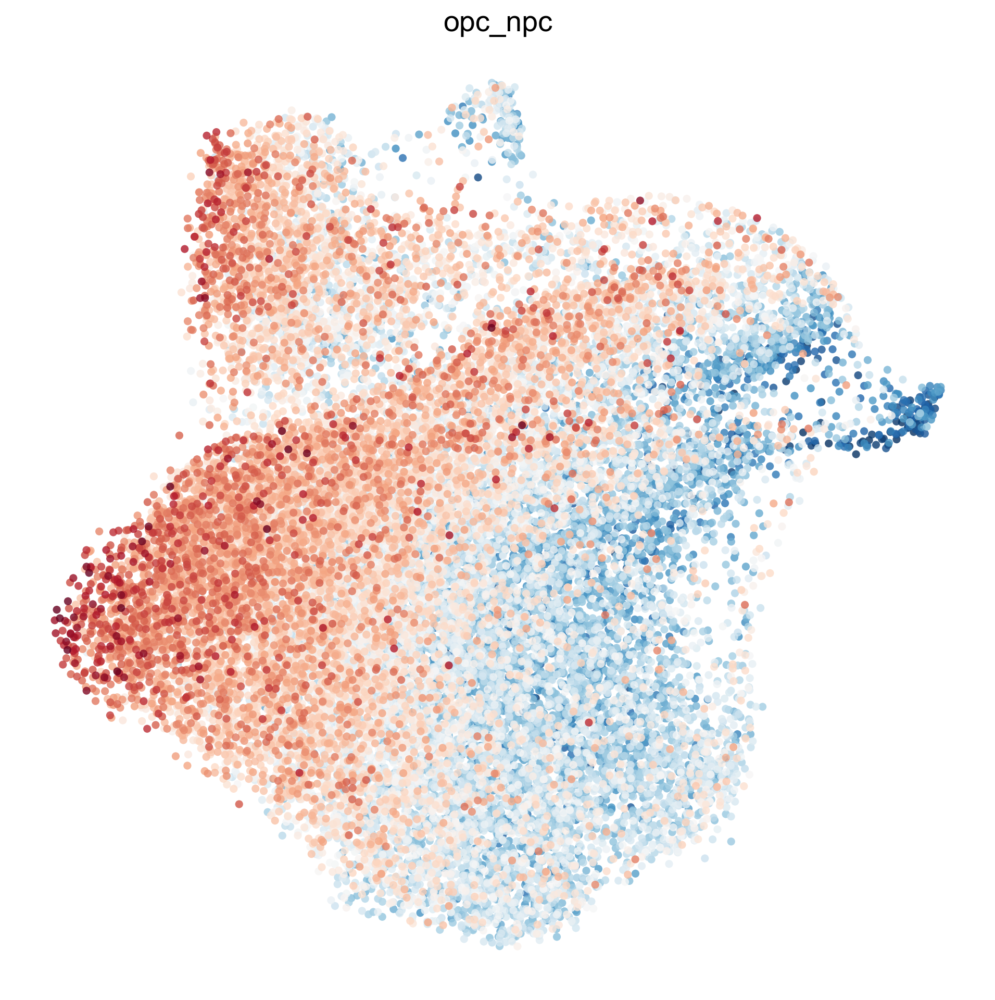

In [318]:
# sc.pl.umap(adata, color=opc_npc_like, size=70)
# add up the expression of opc_npc_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, opc_npc].X.toarray()
except KeyError:
    opc_npc = [g for g in opc_npc if g in adata.var_names]
    data = adata[:, opc_npc].X.toarray()
    
gene_number = len(opc_npc)
opc_npc_expression = np.sum(data, axis=1)
opc_npc_expression = opc_npc_expression / gene_number
adata.obs['opc_npc_expression'] = opc_npc_expression
adata.obs = adata.obs.assign(opc_npc_expression=pd.Series(opc_npc_expression, index=adata.obs.index))
sc.pl.umap(adata, color='opc_npc_expression', vmin=0, vmax=0.5, size=120, alpha=0.8, title='opc_npc', cmap='RdBu_r' ,frameon=False, legend_loc=None, colorbar_loc=None)



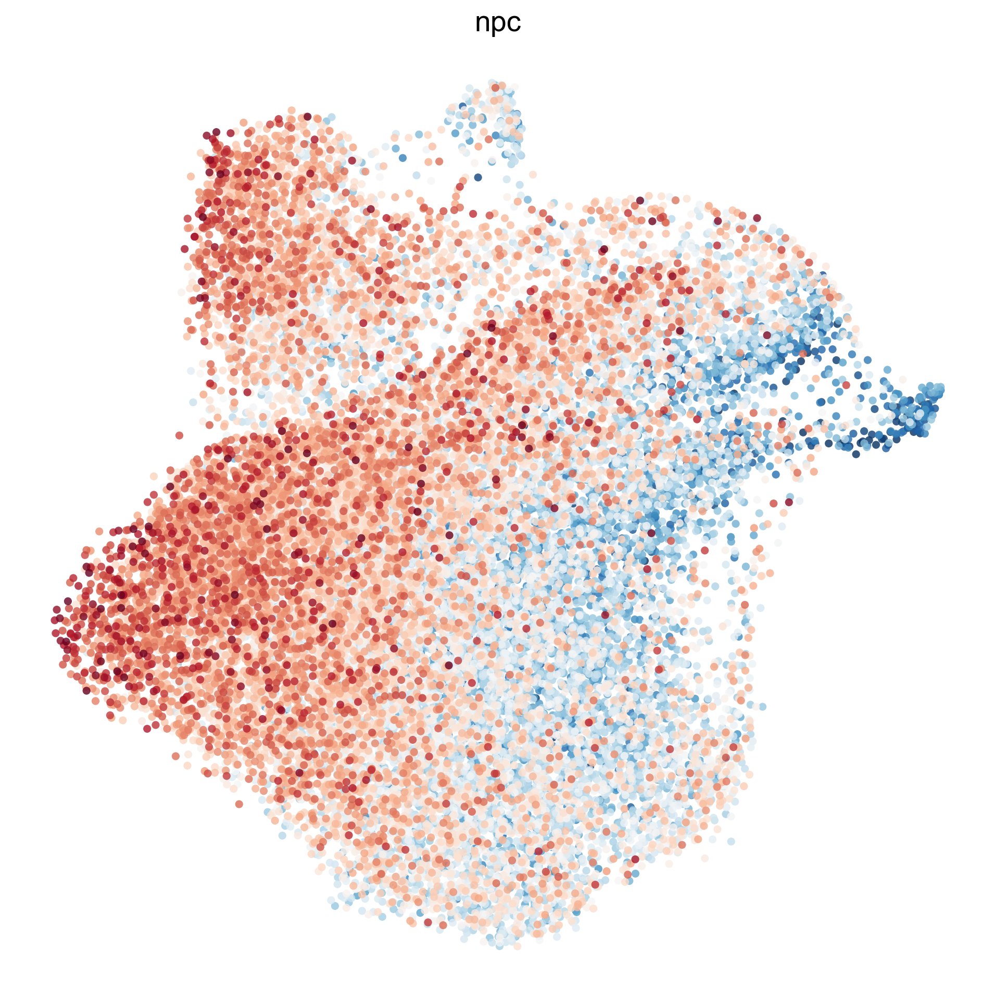

In [319]:
# sc.pl.umap(adata, color=npc_like, size=70)
# add up the expression of npc_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, npc].X.toarray()
except KeyError:
    npc = [g for g in npc if g in adata.var_names]
    data = adata[:, npc].X.toarray()
    
gene_number = len(npc)
npc_expression = np.sum(data, axis=1) / gene_number
adata.obs['npc_expression'] = npc_expression
adata.obs = adata.obs.assign(npc_expression=pd.Series(npc_expression, index=adata.obs.index))
sc.pl.umap(adata, color='npc_expression', vmin=0, vmax=0.5, size=120, alpha=0.8, title='npc', cmap='RdBu_r' ,frameon=False, legend_loc=None, colorbar_loc=None)



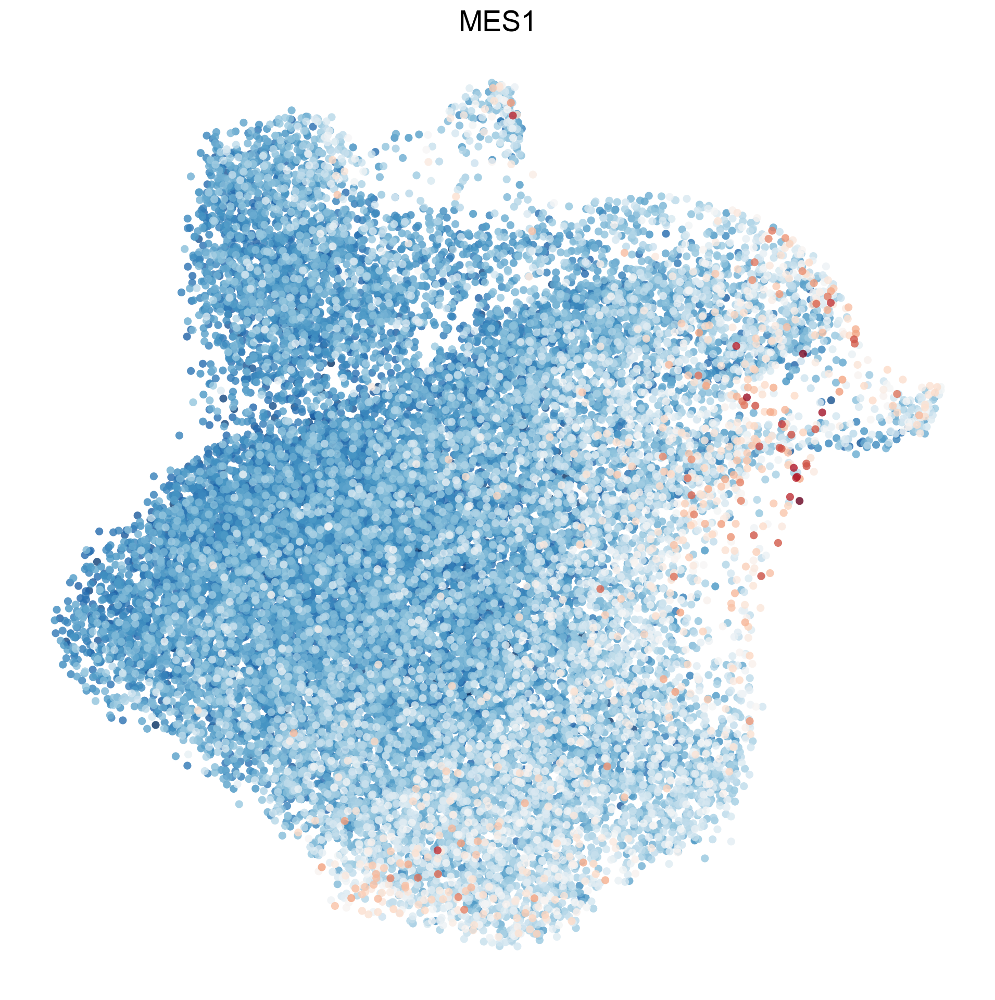

In [320]:
# sc.pl.umap(adata, color=mes_like, size=70)
# add up the expression of mes_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, mes1].X.toarray()
except KeyError:
    mes1 = [g for g in mes1 if g in adata.var_names]
    data = adata[:, mes1].X.toarray()

gene_number = len(mes1)
mes1_expression = np.sum(data, axis=1) / gene_number
adata.obs = adata.obs.assign(mes1_expression=pd.Series(mes1_expression, index=adata.obs.index))
sc.pl.umap(adata, color='mes1_expression', vmin=0, vmax=1, size=120, alpha=0.8, title='MES1', cmap='RdBu_r' ,frameon=False, legend_loc=None, colorbar_loc=None)



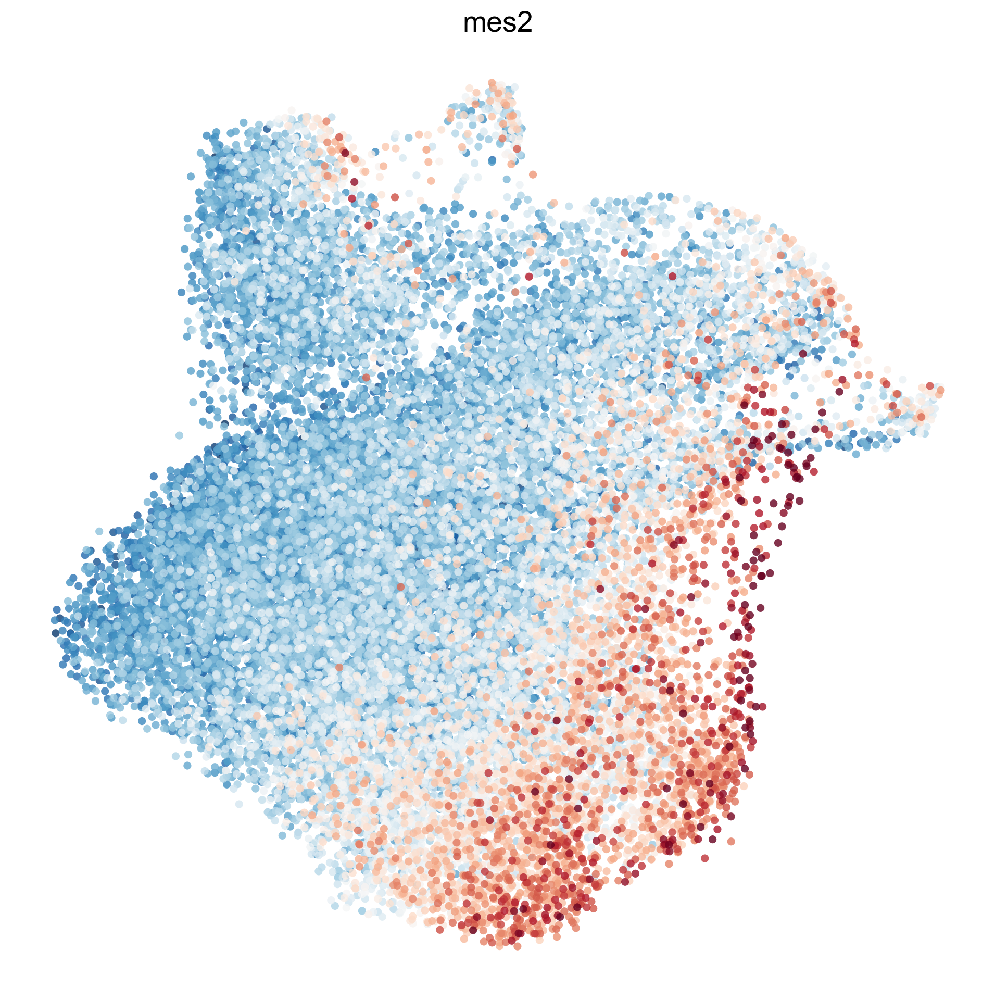

In [321]:
# sc.pl.umap(adata, color=mes_like, size=70)
# add up the expression of mes_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, mes2].X.toarray()
except KeyError:
    mes2 = [g for g in mes2 if g in adata.var_names]
    data = adata[:, mes2].X.toarray()

gene_number = len(mes2)
mes2_expression = np.sum(data, axis=1) / gene_number
adata.obs = adata.obs.assign(mes2_expression=pd.Series(mes2_expression, index=adata.obs.index))
sc.pl.umap(adata, color='mes2_expression', vmin=0, vmax=1, size=120, alpha=0.8, title='mes2', cmap='RdBu_r' ,frameon=False, legend_loc=None, colorbar_loc=None)



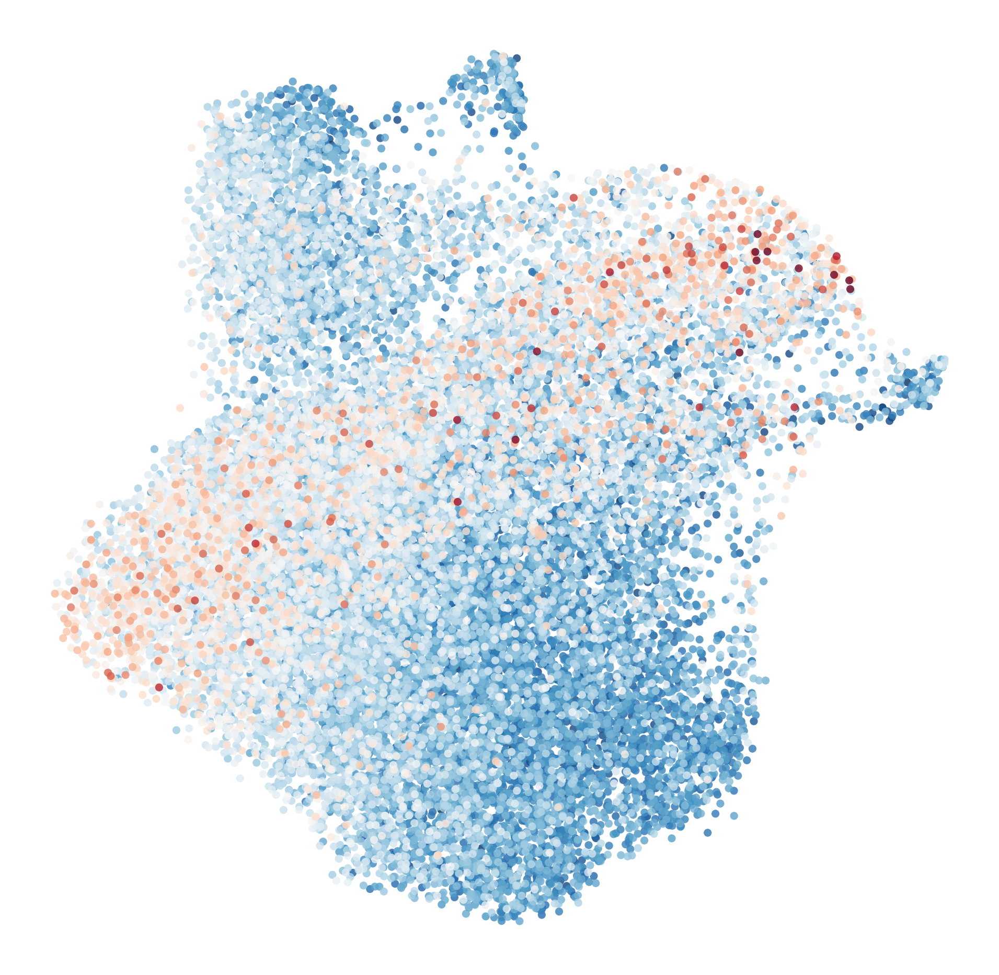

In [322]:
# sc.pl.umap(adata, color=mes_like, size=70)
# add up the expression of mes_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, ac].X.toarray()
except KeyError:
    ac = [g for g in ac if g in adata.var_names]
    data = adata[:, ac].X.toarray()
    
gene_number = len(ac)
ac_expression = np.sum(data, axis=1) / gene_number
adata.obs['ac_expression'] = ac_expression
adata.obs = adata.obs.assign(ac_expression=pd.Series(ac_expression, index=adata.obs.index))
sc.pl.umap(adata, color='ac_expression',vmax=0.8, size=120, alpha=0.8, title='', cmap='RdBu_r' ,frameon=False, legend_loc=None, colorbar_loc=None)



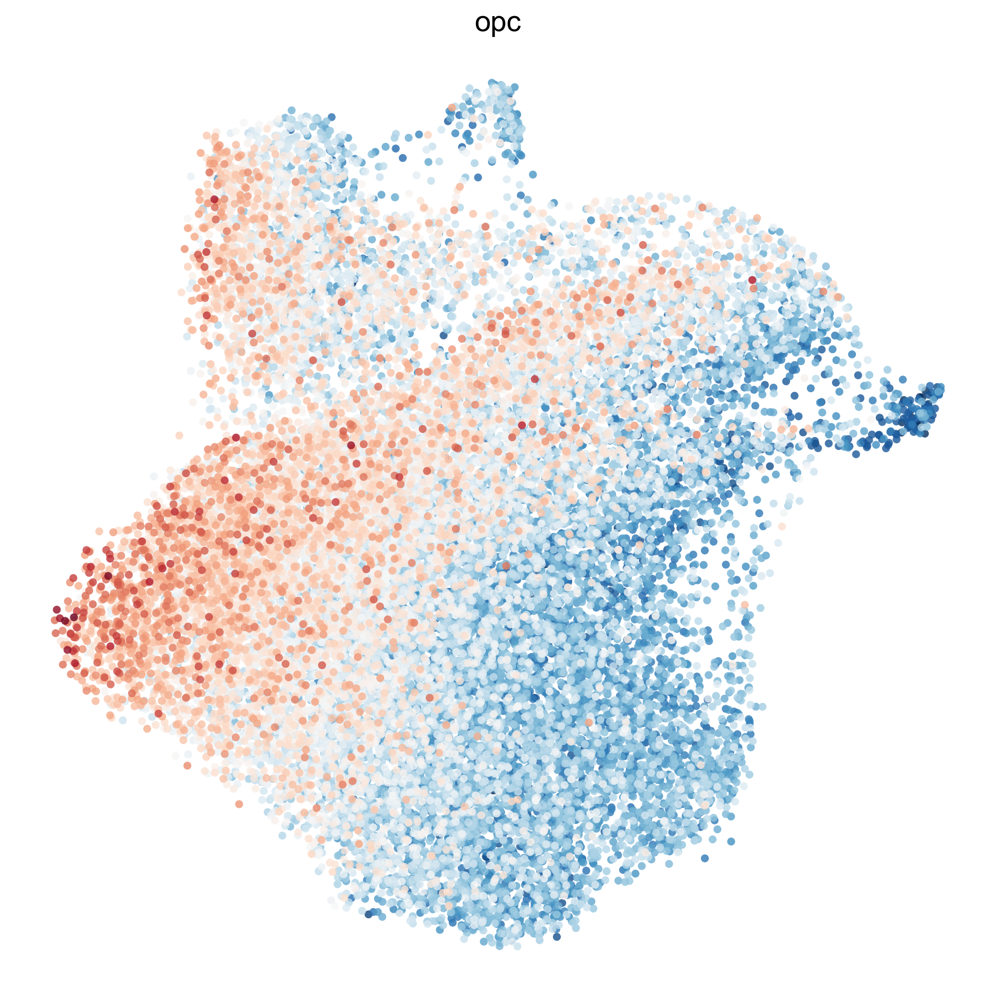

In [323]:
# sc.pl.umap(adata, color=mes_like, size=70)
# add up the expression of mes_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, opc].X.toarray()
except KeyError:
    opc = [g for g in opc if g in adata.var_names]
    data = adata[:, opc].X.toarray()

gene_number = len(opc)
opc_expression = np.sum(data, axis=1) / gene_number
adata.obs['opc_expression'] = opc_expression
adata.obs = adata.obs.assign(opc_expression=pd.Series(opc_expression, index=adata.obs.index))
sc.pl.umap(adata, color='opc_expression', size=120, alpha=0.8, title='opc', cmap='RdBu_r' ,frameon=False, legend_loc=None, colorbar_loc=None)



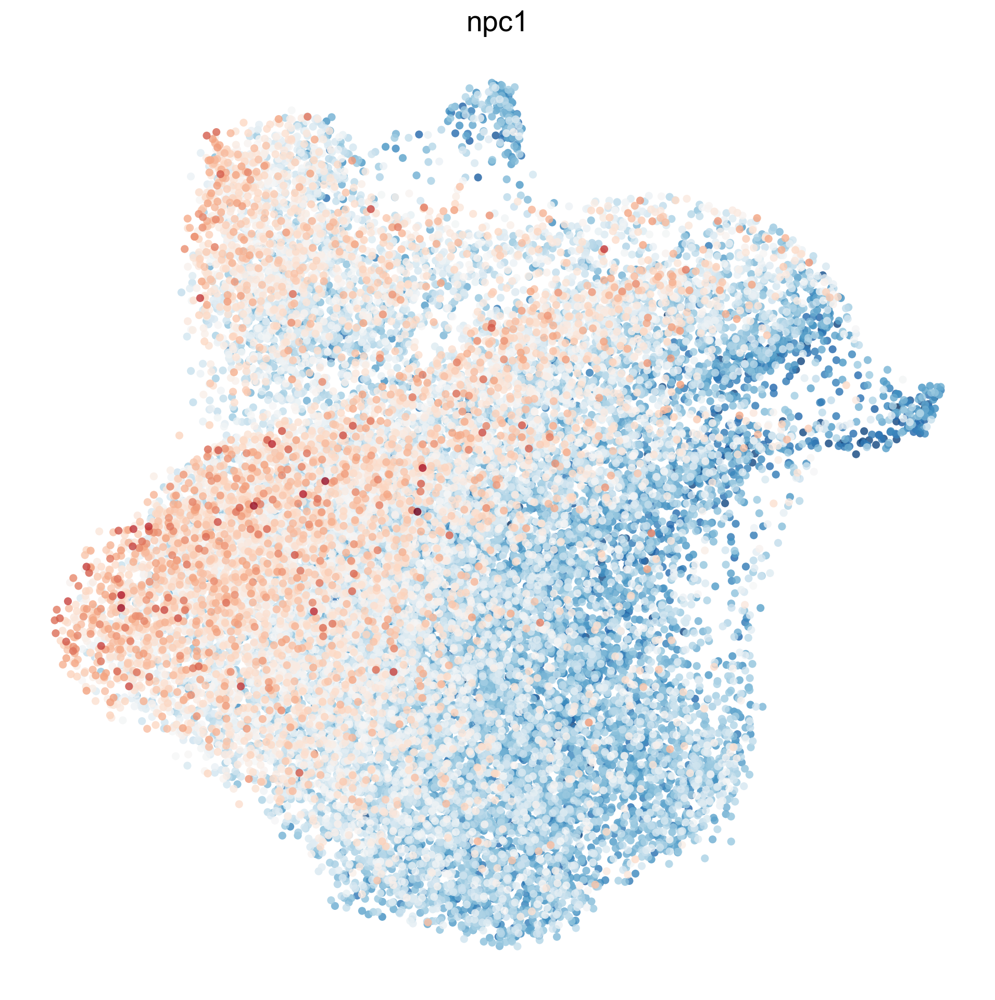

In [324]:
# sc.pl.umap(adata, color=mes_like, size=70)
# add up the expression of mes_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, npc1].X.toarray()
except KeyError:
    npc1 = [g for g in npc1 if g in adata.var_names]
    data = adata[:, npc1].X.toarray()
    
gene_number = len(npc1)
npc1_expression = np.sum(data, axis=1) / gene_number
adata.obs = adata.obs.assign(npc1_expression=pd.Series(npc1_expression, index=adata.obs.index))
sc.pl.umap(adata, color='npc1_expression', size=120, alpha=0.8, title='npc1', cmap='RdBu_r' ,frameon=False, legend_loc=None, colorbar_loc=None)



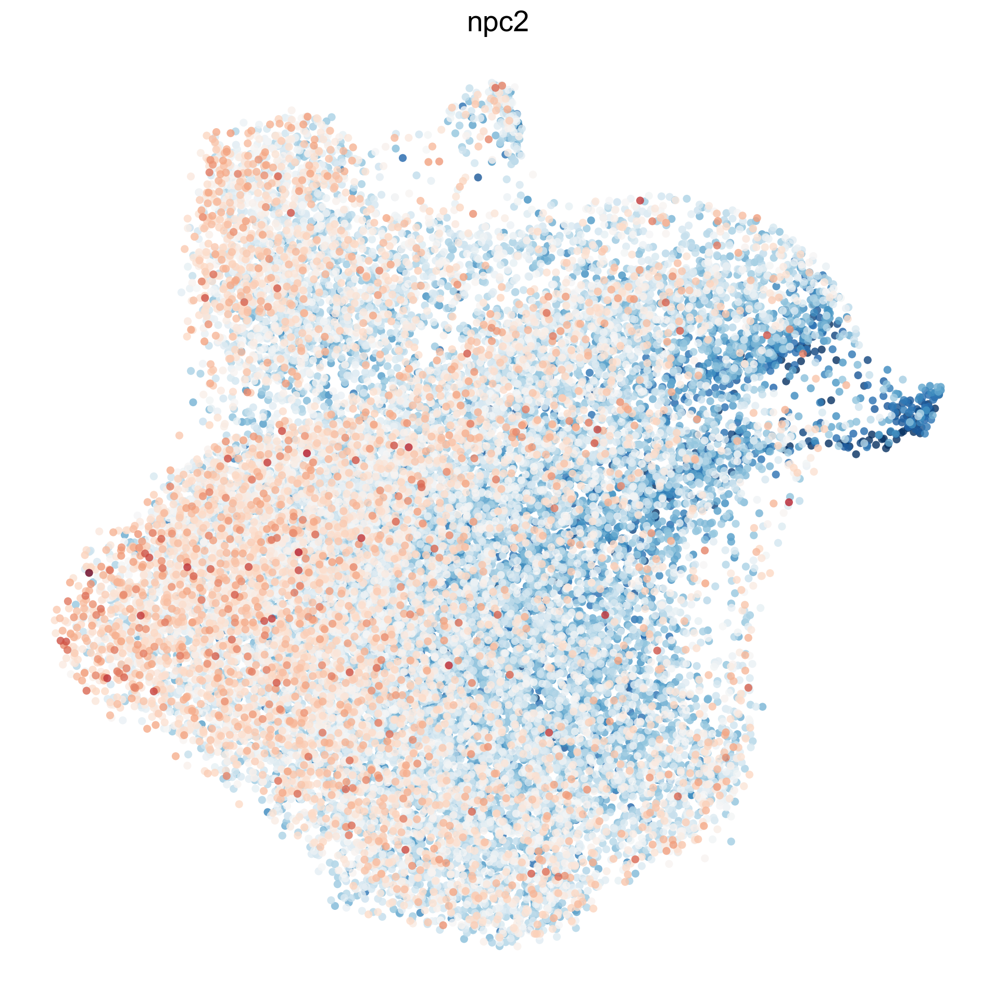

In [325]:
# sc.pl.umap(adata, color=mes_like, size=70)
# add up the expression of mes_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, npc2].X.toarray()
except KeyError:
    npc2 = [g for g in npc2 if g in adata.var_names]
    data = adata[:, npc2].X.toarray()
    
gene_number = len(npc2)
npc2_expression = np.sum(data, axis=1) / gene_number
adata.obs = adata.obs.assign(npc2_expression=pd.Series(npc2_expression, index=adata.obs.index))
sc.pl.umap(adata, color='npc2_expression', size=120, alpha=0.8, title='npc2', cmap='RdBu_r' ,frameon=False, legend_loc=None, colorbar_loc=None)



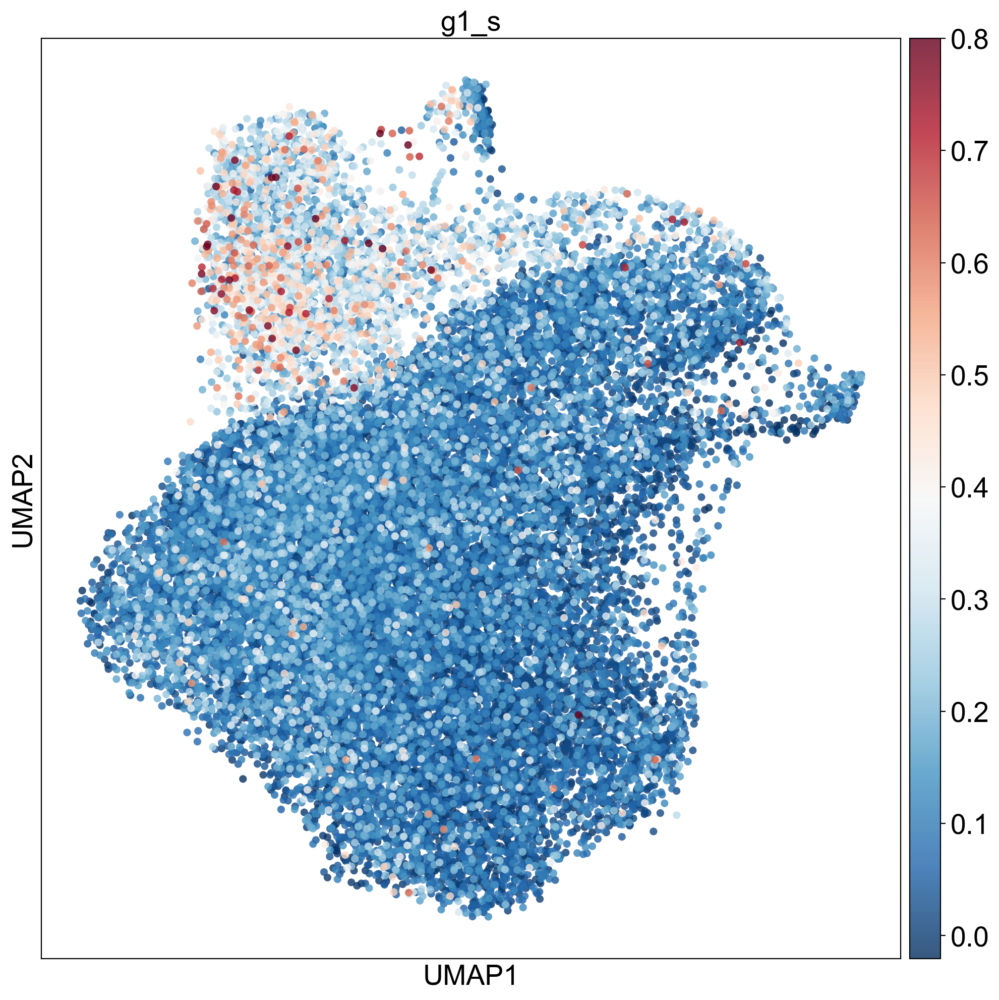

In [326]:
# sc.pl.umap(adata, color=mes_like, size=70)
# add up the expression of mes_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, g1_s].X.toarray()
except KeyError:
    g1_s = [g for g in g1_s if g in adata.var_names]
    data = adata[:, g1_s].X.toarray()
    
gene_number = len(g1_s)
g1_s_expression = np.sum(data, axis=1) / gene_number
adata.obs = adata.obs.assign(g1_s_expression=pd.Series(g1_s_expression, index=adata.obs.index))
# sc.pl.umap(adata, color='g1_s_expression', vmax=15, size=120, alpha=0.8, title='g1_s', cmap='RdBu_r' ,frameon=False, legend_loc=None, colorbar_loc=None)
sc.pl.umap(adata, color='g1_s_expression', vmax=0.8, size=120, alpha=0.8, title='g1_s' , cmap='RdBu_r')




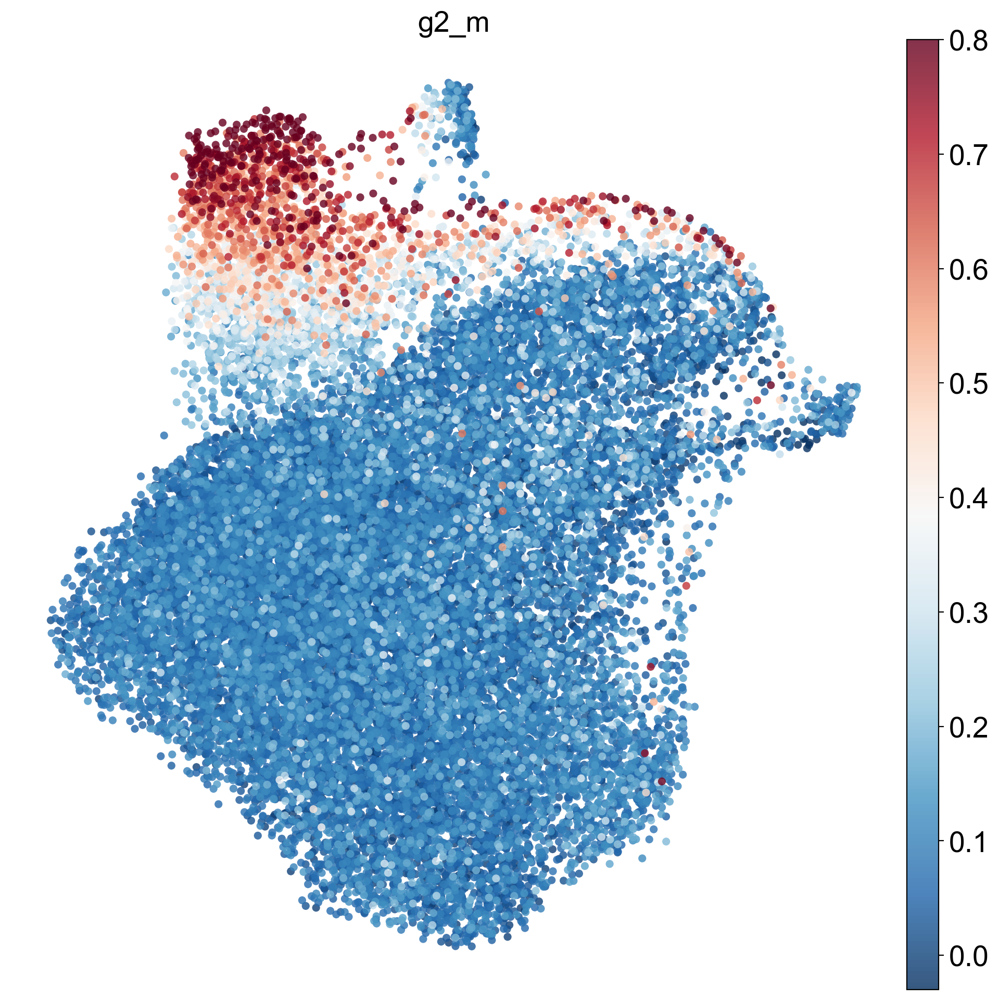

In [327]:
# sc.pl.umap(adata, color=mes_like, size=70)
# add up the expression of mes_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, g2_m].X.toarray()
except KeyError:
    g2_m = [g for g in g2_m if g in adata.var_names]
    data = adata[:, g2_m].X.toarray()
    
gene_number = len(g2_m)
g2_m_expression = np.sum(data, axis=1) / gene_number
adata.obs['g2_m_expression'] = g2_m_expression
adata.obs = adata.obs.assign(g2_m_expression=pd.Series(g2_m_expression, index=adata.obs.index))
# sc.pl.umap(adata, color='g2_m_expression', vmax=20, size=120, alpha=0.8, title='g2_m', cmap='RdBu_r' ,frameon=False, legend_loc=None, colorbar_loc=None)
sc.pl.umap(adata, color='g2_m_expression', vmax=0.8, size=120, alpha=0.8, title='g2_m' ,frameon=False, legend_loc=None, cmap='RdBu_r')



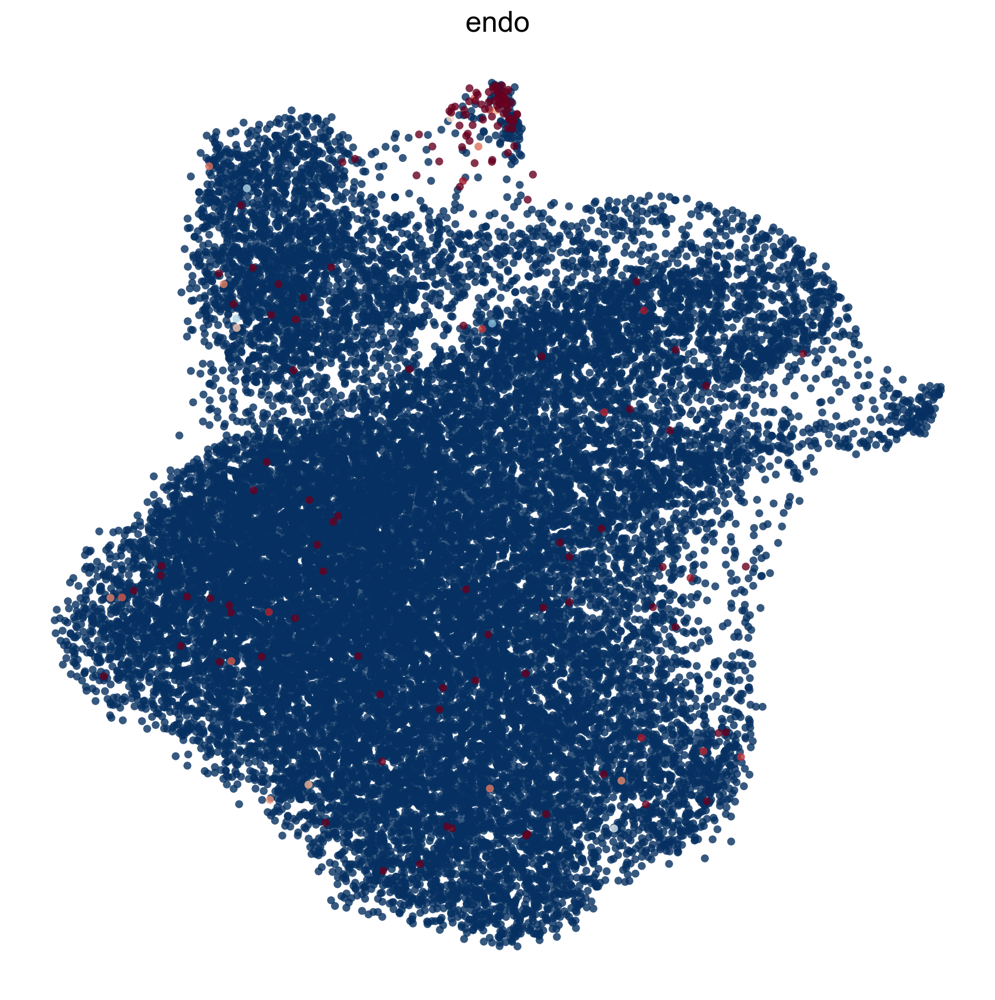

In [328]:
# sc.pl.umap(adata, color=mes_like, size=70)
# add up the expression of mes_like genes and put it in adata.var
# try and remove the genes that cause a key error
try:
    data = adata[:, endo].X.toarray()
except KeyError:
    endo = [g for g in endo if g in adata.var_names]
    data = adata[:, endo].X.toarray()
    
gene_number = len(endo)
endo_expression = np.sum(data, axis=1) / gene_number
adata.obs['endo_expression'] = endo_expression
adata.obs = adata.obs.assign(endo_expression=pd.Series(endo_expression, index=adata.obs.index))
sc.pl.umap(adata, color='endo_expression', vmax=1, vmin=0, size=120, alpha=0.8, title='endo' ,frameon=False, legend_loc=None, colorbar_loc=None, cmap='RdBu_r')




In [329]:
# drop cell_type_f
# adata.obs = adata.obs.drop(columns=['cell_type_f'])
# # Annotating types
adata.obs.loc[adata.obs.louvain == '2', 'cell_type_f'] = 'Mesenchymal'
adata.obs.loc[adata.obs.louvain == '7', 'cell_type_f'] = 'Mesenchymal'
adata.obs.loc[adata.obs.louvain == '8', 'cell_type_f'] = 'Mesenchymal'
adata.obs.loc[adata.obs.louvain == '10', 'cell_type_f'] = 'Mesenchymal'

adata.obs.loc[adata.obs.louvain == '4', 'cell_type_f'] = 'Astrocyte'
adata.obs.loc[adata.obs.louvain == '5', 'cell_type_f'] = 'Astrocyte'

# adata.obs.loc[adata.obs.louvain == '5', 'cell_type_f'] ='Cancer Stem Cell' 

adata.obs.loc[adata.obs.louvain == '0', 'cell_type_f'] = 'Oligodendrocyte and Nueral Progenitor Cells'
# adata.obs.loc[adata.obs.louvain == '5', 'cell_type_f'] = 'Oligodendrocyte and Nueral Progenitor Cells'
adata.obs.loc[adata.obs.louvain == '6', 'cell_type_f'] = 'Oligodendrocyte and Nueral Progenitor Cells'

adata.obs.loc[adata.obs.louvain == '3', 'cell_type_f'] = 'Cycling Cells'

adata.obs.loc[adata.obs.louvain == '9', 'cell_type_f'] = 'Endothelial'



/Users/shaunie/Desktop/hu-glioblastoma/.conda/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/shaunie/Desktop/hu-glioblastoma/.conda/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


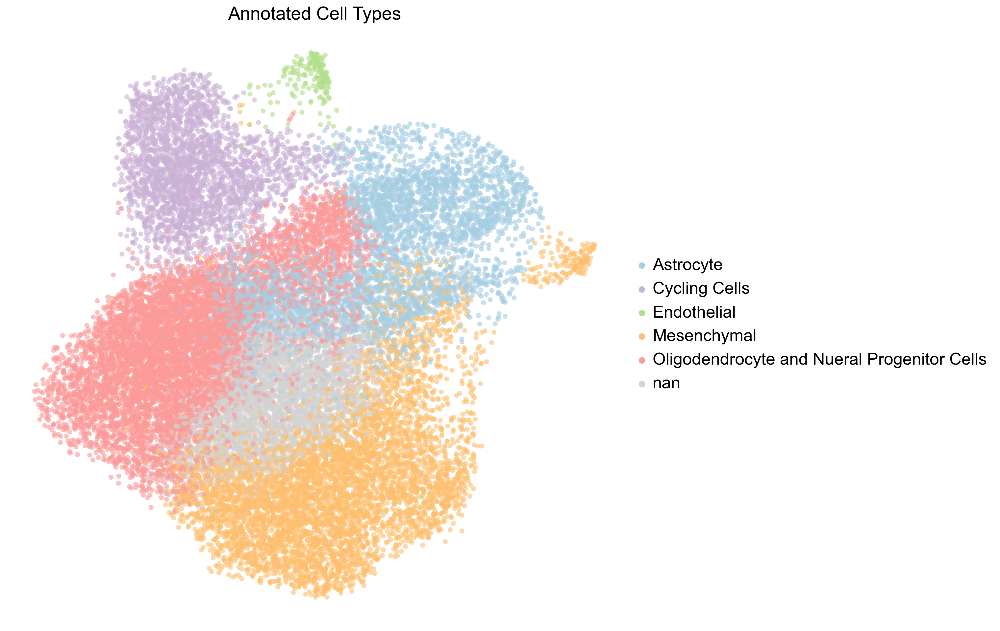

In [330]:
# add opacity
# choose colorblind friendly colors
# choose order of colors from Paired
palette = sns.color_palette("Paired")
# convert to hex
palette = palette.as_hex()
# change the order of colors
palette = [palette[0], palette[8], palette[2], palette[6], palette[4]]
# make the last a light gray
palette.append('#D3D3D3')

sc.pl.umap(adata, color="cell_type_f", title="Annotated Cell Types", size=120, alpha=0.6, palette=palette, frameon=False, colorbar_loc=None)
# set font size
plt.rcParams.update({'font.size': 50})

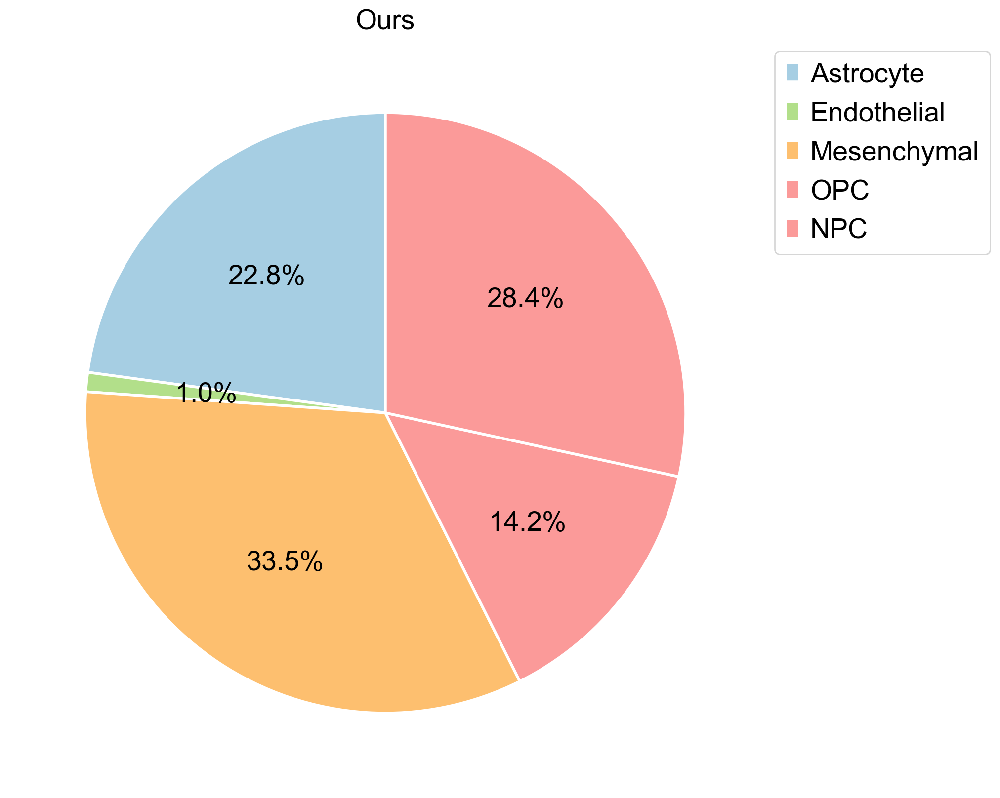

In [331]:

# use the following order and colors:

# make a dataframe of the cell types
cell_type_df = pd.DataFrame(adata.obs['cell_type_f'].value_counts())
# split progenitor values into two, 2/3 are NPC and 1/3 are OPC
cell_type_df.loc['OPC'] = cell_type_df.loc['Oligodendrocyte and Nueral Progenitor Cells']/3
cell_type_df.loc['NPC'] = 2*cell_type_df.loc['Oligodendrocyte and Nueral Progenitor Cells']/3
cell_type_df = cell_type_df.drop(['Oligodendrocyte and Nueral Progenitor Cells'])
# # rename the progenitor values
cell_type_df = cell_type_df.rename(index={'OPC': 'OPC', 'NPC': 'NPC'})

# # reorder to Endothelial, Mesenchymal, OPC-like, Astrocyte-like, Proneural-like
cell_type_df = cell_type_df.reindex(['Endothelial', 'Mesenchymal','Astrocyte', 'OPC', 'NPC'])
cell_type_df = cell_type_df.reindex(['Astrocyte', 'Endothelial','Mesenchymal', 'OPC', 'NPC'])

palette = sns.color_palette("Paired")
# convert to hex
palette = palette.as_hex()
# change the order of colors
palette = [palette[0], palette[2], palette[6], palette[4], palette[4]]


cell_type_df
# make a pie chart of the cell types, remove the labels from the chart itself, outline black, percentage to 1 decimal place and farther out
cell_type_df.plot.pie(y='count', figsize=(20, 10), colors=palette, autopct='%1.1f%%', startangle=90, legend=True, fontsize=20, title='Ours', ylabel='', labeldistance=None, wedgeprops=dict(linewidth=2, edgecolor='white'), textprops={'fontsize': 20})
# make legend outside of pie chart
plt.legend(bbox_to_anchor=(1,1), loc="upper left", prop={'size': 20})
# save figure   
# plt.savefig('figures/pie_chart_our_classifications.png', bbox_inches='tight', dpi=300)

In [308]:
adata
adata# if perivascular if over 3.5, label class "perivascular"
adata.obs["class"] = 'other'
adata.obs["class"] = np.where(adata.obs['mes_expression'] > 0.25, "Mesenchymal", adata.obs["class"])
adata.obs["class"] = np.where(adata.obs['ac_expression'] > 0.2, "Astrocyte", adata.obs["class"])
adata.obs["class"] = np.where(adata.obs['g2_m_expression'] > 0.2, "Cycling", adata.obs["class"])
adata.obs["class"] = np.where(adata.obs['opc_expression'] > 0.2, "OPC", adata.obs["class"])
adata.obs["class"] = np.where(adata.obs['npc_expression'] > 0.2, "NPC", adata.obs["class"])
adata.obs["class"] = np.where(adata.obs['endo_expression'] > 0.25, "Endothelial", adata.obs["class"])


# drop everything other
adata = adata[adata.obs["class"] != "other", :]
# 
adata.obs["class"] = pd.Categorical(adata.obs["class"], categories=["Mesenchymal","Cycling", "OPC", "NPC","Astrocyte", "Endothelial"])
# drop the endo cells
adata = adata[adata.obs["class"] != "Endothelial", :]

/var/folders/td/y1xv90r510924xxsnlfkjgrc0000gn/T/ipykernel_41251/292499914.py:15: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["class"] = pd.Categorical(adata.obs["class"], categories=["Mesenchymal","Cycling", "OPC", "NPC","Astrocyte", "Endothelial"])


In [373]:
from IPython.display import clear_output

# make a heatmap of the cell types
# average adata into bins matching cell_type_f

# take a random 1/10th of the data
adata_sample = adata.copy()
subset_genes =  mes + opc + npc + ac + endo + g1_s + g2_m


problem = ['MALAT1', 'ASCL1', 'VIM', 'C14orf23', 'C8orf4', 'ERO1L', 'FIBIN', 'GATM-AS1', 'GPR56', 'H2AFZ', 'H3F3B', 'HIST1H4C', 'HMP19', 'HN1', 'HRASLS', 'KIAA0101', 'LOC150568', 'LOC90834', 'LPPR1', 'MLF1IP', 'MT1E', 'NCRUPAR', 'PPAP2B', 'SEPT3', 'SERPINA3', 'TMEM161B-AS1', 'TMEM206', 'WARS']
# # remove problem genes
subset_genes = [g for g in all_genes if g not in problem]

# order all_genes by 
for i, gene in enumerate(subset_genes):
    clear_output()
    print(i, '/', len(subset_genes), gene)    
    data = adata_sample[:, gene]
    if data.var.loc[gene, 'mean_counts'] < 0.3:
        print(gene)
        subset_genes = [g for g in subset_genes if g != gene]
    # if data.var.loc[gene, 'n_cells'] > 8000:
    #     print(gene)
    #     subset_genes = [g for g in subset_genes if g != gene]
    
# make a dataframe of just the subset genes



   
   
sc.pl.heatmap(adata_sample, var_names=subset_genes, groupby='cell_type_f', cmap='RdBu_r', )
# save figure
# fig.savefig('figures/heatmap_our_classifications.png', bbox_inches='tight', dpi=300)


395 / 85 PECAM1
PECAM1


In [ ]:
adata_sample
subset_df = adata_sample[:, subset_genes].to_df()
# just get an array of the column names
genes = subset_df.columns

In [365]:
# bin and blur alittle bit the genes a little bit
# remove 
# normalize the data

# remove repeats for subs
# reprder palette to be mes opc npc ac endo
palette = sns.color_palette("Paired")
# convert to hex
palette = palette.as_hex()
# change the order of colors


order = ['Mesenchymal', 'Cycling Cells', 'Oligodendrocyte and Nueral Progenitor Cells', 'Astrocyte', 'Endothelial', 'nan']
adata_sample.obs['cell_type_f'] = adata_sample.obs['cell_type_f'].cat.reorder_categories(order)
adata_sample.uns['cell_type_f_colors'] = [palette[6], palette[8],palette[4], palette[0], palette[2], 'gray']

# within class order by mean expression
adata_sample.var['mean'] = adata_sample.X.mean(axis=0)
adata_sample.var.sort_values(by='mean', ascending=False, inplace=True)

subset_with_data = {}
for gene in subset_genes:
    dispersion_norm = adata_sample.var.loc[gene, 'dispersions_norm']
    subset_with_data[gene] = data

# sort subset by dispersion
sorted_subset = sorted(subset_with_data.items(), key=lambda x: x[1], reverse=True)

subset_genes = [x[0] for x in sorted_subset]
    


# sc.pl.heatmap(adata, var_names=subset_genes, groupby='class', cmap='RdBu_r', vmax=3.9, vmin=0.2, swap_axes=True, figsize=(10, 4))
sc.pl.heatmap(adata_sample, var_names=subset_genes, groupby='cell_type_f', cmap='RdBu_r', vmin=0.2, vmax=4.5, swap_axes=True, figsize=(10, 4))


TypeError: '<' not supported between instances of 'AnnData' and 'AnnData'

In [366]:
subset_genes

['CENPF',
 'SOX4',
 'RBM6',
 'HNRNPH1',
 'PTMA',
 'TRA2A',
 'PTPRS',
 'CHD7',
 'NFIB',
 'TFDP2',
 'TCF4',
 'BAZ2B',
 'EGFR',
 'EEF1A1',
 'PABPC1',
 'SOX4',
 'TCF12',
 'MAP2',
 'PTPRS',
 'CHD7',
 'TUBA1A',
 'ETV1',
 'HIP1',
 'SERINC5',
 'GLCCI1',
 'SOX4',
 'MAP1B',
 'RBFOX2',
 'DPYSL3',
 'KIF5C',
 'TCF4',
 'NFIB',
 'CEP170',
 'SOX2-OT',
 'PTPRZ1',
 'VCAN',
 'GPM6B',
 'SERINC5',
 'ANXA2',
 'CD44',
 'NAMPT',
 'SOD2',
 'LGALS3',
 'WWTR1',
 'HILPDA',
 'SQSTM1',
 'NAMPT',
 'LGALS3',
 'SLC2A3',
 'FTL',
 'HSPA5',
 'ANXA2',
 'P4HA1',
 'PGK1',
 'HSPA9',
 'SLC1A3',
 'SPARCL1',
 'PON2',
 'PTPRZ1',
 'GPM6B']